In [1]:
using Flight.FlightCore.Systems
using Flight.FlightCore.Plotting

using Flight.FlightLib
using Flight.FlightAircraft
using Flight.FlightAircraft.C172X.C172XControl
using Flight.FlightLib.Control.Discrete: PIDParams
using Flight.FlightLib.Control.PIDOpt: Settings, Metrics, optimize_PID, build_PID, check_results

using UnPack
using ControlSystems
using RobustAndOptimalControl
using ComponentArrays
using LinearAlgebra

In [ ]:
global_search = false

ac = Cessna172Xv0(NED()) |> System #linearization requires NED kinematics

# design_point = C172.TrimParameters()
design_point = C172.TrimParameters(EAS = 25, flaps = 1.0)
# design_point = C172.TrimParameters(EAS = 28)
# design_point = C172.TrimParameters(EAS = 40)

#complete longitudinal model
lss_lon = Control.Continuous.LinearizedSS(ac, design_point; model = :lon);
P_lon = named_ss(lss_lon);

x_labels_lon = keys(lss_lon.x0) |> collect
y_labels_lon = keys(lss_lon.y0) |> collect
u_labels_lon = keys(lss_lon.u0) |> collect

lss_lon.A[:h, :] |> display
lss_lon.A[:, :h] |> display
lss_lon.C[:, :h] |> display


ComponentVector{Float64}(q = 0.0, θ = 26.285871148109436, v_x = 0.2389897876489821, v_z = -0.9710154466284471, h = 0.0, α_filt = 0.0, ω_eng = 0.0, thr_p = 0.0, ele_p = 0.0)

ComponentVector{Float64}(q = 1.141510729496108e-6, θ = -6.546777413883103e-13, v_x = -0.0002237975567189379, v_z = 0.0009297915784441085, h = 0.0, α_filt = 0.0, ω_eng = -0.026545767232674326, thr_p = 0.0, ele_p = 0.0)

ComponentVector{Float64}(q = 0.0, θ = 0.0, v_x = 0.0, v_z = 0.0, h = 1.0, α_filt = 0.0, ω_eng = 0.0, thr_p = 0.0, ele_p = 0.0, f_x = -0.0002238376083828154, f_z = 0.0009327623957679386, α = 0.0, EAS = -0.0012282587233043852, TAS = 0.0, γ = 0.0, climb_rate = 0.0, throttle_cmd = 0.0, elevator_cmd = 0.0)

As one would expect, $\dot{h}$ is nonzero for nonzero $\theta$. This would be a problem when designing a LQR tracker for which the choice of command variables involves non-zero steady state $\theta$. Since we cannot maintain constant altitude with an arbitrary $\theta$, true static equilibrium will not exist and the block $H_x F^{-1} G$ in the feedforward gain matrix required for tracking such command variables would be singular. This would not be an issue if we picked for instance $h$ and $EAS$ as command variables, because true equilibrium exists for an arbitrary combination of the two. However, this is not an appealing choice, because we would like to be able to control the pitch axis explicitly, rather than implicitly through $h$.

To handle this issue, we could partition the state and work with quasi-static equilibrium. However, since this is annoying, and the coupling of $h$ into the remaining states is very weak, we can simply drop $h$ from the state, design the desired LQR trackers on the reduced plant, and then connect them back to the full plant. This has a price to pay: ignoring the (small) effect of altitude causes (small) steady state errors when tracking climb-rate, EAS or throttle.

In this particular case, we intend to design a throttle-decoupled LQR tracker for pitch SAS, with only elevator as both command variable and control input. We will therefore use a SISO model retaining only pitch dynamics. Since we are only keeping elevator command as an input, we need to drop all engine-related states in addition to $h$ in order to keep the system controllable.

In [3]:
x_labels_pit = [:q, :θ, :v_x, :v_z, :α_filt, :ele_p]
y_labels_pit = vcat(x_labels_pit, [:f_x, :f_z, :α, :EAS, :TAS, :γ, :climb_rate, :elevator_cmd])
u_labels_pit = [:elevator_cmd,]

#pitch dynamics model
lss_pit = Control.Continuous.submodel(lss_lon; x = x_labels_pit, u = u_labels_pit, y = y_labels_pit)
P_pit = named_ss(lss_pit);

In [4]:
dampreport(P_lon)
dampreport(P_pit)

|        Pole        |   Damping     |   Frequency   |   Frequency   | Time Constant |
|                    |    Ratio      |   (rad/sec)   |     (Hz)      |     (sec)     |
+--------------------+---------------+---------------+---------------+---------------+
| -0.000731          |  1            |  0.000731     |  0.000116     |  1.37e+03     |
| -0.0588 ±  0.457im |  0.128        |  0.46         |  0.0733       |  17           |
| -2.71   ±   3.67im |  0.595        |  4.56         |  0.726        |  0.368        |
| -9.19              |  1            |  9.19         |  1.46         |  0.109        |
| -20                |  1            |  20           |  3.18         |  0.05         |
| -20                |  1            |  20           |  3.18         |  0.05         |
| -49.5              |  1            |  49.5         |  7.87         |  0.0202       |
|        Pole        |   Damping     |   Frequency   |   Frequency   | Time Constant |
|                    |    Ratio      |   (r

In [5]:
cond(P_lon.A) |> display
cond(P_pit.A) |> display

3.3707031248631425e7

4908.452990140667

In [6]:
# controllability(P_red)
controllability(P_pit)

(iscontrollable = true, ranks = [6, 6, 6, 6, 6, 6], sigma_min = [0.005932995780749447, 3.9440195765434267, 1.4670343101011205, 1.4670343101011205, 0.03307974612728198, 0.03307974612728198])

## 1. Pitch Stability Augmentation

In [7]:
# ensure consistency in component selection and ordering between our pitch
# design model and avionics implementation for state and control vectors
@assert tuple(x_labels_pit...) === propertynames(C172XControl.XPitch())
# @assert tuple(u_labels_pit...) === propertynames(C172XControl.UPitch())

x_trim = lss_pit.x0
u_trim = lss_pit.u0

n_x = length(x_labels_pit)
n_u = length(u_labels_pit)

@show tuple(x_labels_pit...)
@show propertynames(C172XControl.XPitch())

tuple(x_labels_pit...) = (:q, :θ, :v_x, :v_z, :α_filt, :ele_p)
propertynames(C172XControl.XPitch()) = (:q, :θ, :v_x, :v_z, :α_filt, :ele_p)


(:q, :θ, :v_x, :v_z, :α_filt, :ele_p)

In [8]:
z_labels = [:elevator_cmd,]

# @assert tuple(z_labels...) === propertynames(C172XControl.ZPitch())
z_trim = lss_pit.y0[z_labels]
n_z = length(z_labels)

F = lss_pit.A
G = lss_pit.B
Hx = lss_pit.C[z_labels, :]
Hu = lss_pit.D[z_labels, :]

@unpack v_x, v_z = lss_pit.x0
v_norm = norm([v_x, v_z])

#weight matrices
Q = C172XControl.XPitch(q = 1, θ = 20, v_x = 0.1/v_norm, v_z = 1/v_norm, α_filt = 0, ele_p = 0) |> diagm
# R = C172XControl.UPitch(elevator_cmd = 2) |> diagm
R = [2.0] |> diagm #elevator_cmd weight

#feedback gain matrix
C_fbk = lqr(P_pit, Q, R)

#forward gain matrix
A = [F G; Hx Hu]
B = inv(A)
B_12 = B[1:n_x, n_x+1:end]
B_22 = B[n_x+1:end, n_x+1:end]
C_fwd = B_22 + C_fbk * B_12

#no integral control
C_int = zeros(n_u, n_z)

#useful signal labels
u_labels_pit_fbk = Symbol.(string.(u_labels_pit) .* "_fbk")
u_labels_pit_fwd = Symbol.(string.(u_labels_pit) .* "_fwd")
u_labels_pit_sum = Symbol.(string.(u_labels_pit) .* "_sum")
z_labels_sp = Symbol.(string.(z_labels) .* "_sp")

C_fbk_ss = named_ss(ss(C_fbk), u = x_labels_pit, y = u_labels_pit_fbk)
C_fwd_ss = named_ss(ss(C_fwd), u = z_labels_sp, y = u_labels_pit_fwd)

#summing junctions
# throttle_sum = sumblock("throttle_cmd_sum = throttle_cmd_fwd- throttle_cmd_fbk")
elevator_sum = sumblock("elevator_cmd_sum = elevator_cmd_fwd - elevator_cmd_fbk")

connections = vcat(
    Pair.(x_labels_pit, x_labels_pit),
    Pair.(u_labels_pit_fbk, u_labels_pit_fbk),
    Pair.(u_labels_pit_sum, u_labels_pit),
    Pair.(u_labels_pit_fwd, u_labels_pit_fwd)
    )

#connect to the reduced pitch dynamics (this one is for comparison only)
P_pit_te = connect([P_pit, elevator_sum, C_fbk_ss, C_fwd_ss],
    connections; w1 = z_labels_sp, z1 = P_pit.y)


NamedStateSpace{Continuous, Float64}
A = 
  -2.6099773071907895   -3.832338954221082e-6    0.8147323330498819     -3.4465577554028677     75.26074143006188     3.772333240056046
   0.9999931728420162   -3.966237321384963e-14   1.5324291033336962e-7   3.771617064131847e-8    0.0                  0.0
  -4.5375535667748235   -9.493769483375146      -0.6231618686412566      2.6019691840469052    -49.478122205082805   -2.7380678820114106
  24.82607194756126     -2.33659608956206       -0.3023313824601634     -1.7946097914438695     15.8801270564192      1.169662085372745
   0.0                   0.0                    -0.4546001685813564      1.8470403877423882    -50.0                  0.0
 -10.967154513059166   -56.440982067212666      -0.41816804524129236     1.4308241873277274    -15.626713084380238  -21.842765768867956
B = 
  0.0
  0.0
  0.0
  0.0
  0.0
 26.97003811607076
C = 
  1.0                   0.0                     0.0                    0.0                   0.0              

Now, after designing the LQR tracker on the reduced plant, we connect it to the full longitudinal dynamics.

In [9]:
#connect to the complete longitudinal dynamics (this is the one we'll keep)
P_lon_te = connect([P_lon, elevator_sum, C_fbk_ss, C_fwd_ss],
    connections; w1 = [:throttle_cmd, :elevator_cmd_sp], z1 = P_lon.y)

#add dummy system to rename input throttle_cmd to throttle_cmd_sp
D_thr = named_ss(ss(1), u = [:throttle_cmd_sp,], y = [:throttle_cmd_sp, ])
P_te = connect([P_lon_te, D_thr], [:throttle_cmd_sp => :throttle_cmd,];
    w1 = [:throttle_cmd_sp, :elevator_cmd_sp], z1 = P_lon_te.y)

display(C_fbk_ss)
display(C_fwd_ss)
# dampreport(P_pit_te)
# dampreport(P_te)

NamedStateSpace{Continuous, Float64}
D = 
 0.5483577256529583  2.822049103360633  0.020908402308146803  -0.07154120946877177  0.781335654219012  0.09213828844339784

Continuous-time state-space model
With state  names: 
     input  names: q θ v_x v_z α_filt ele_p
     output names: elevator_cmd_fbk


NamedStateSpace{Continuous, Float64}
D = 
 1.3485019058035381

Continuous-time state-space model
With state  names: 
     input  names: elevator_cmd_sp
     output names: elevator_cmd_fwd


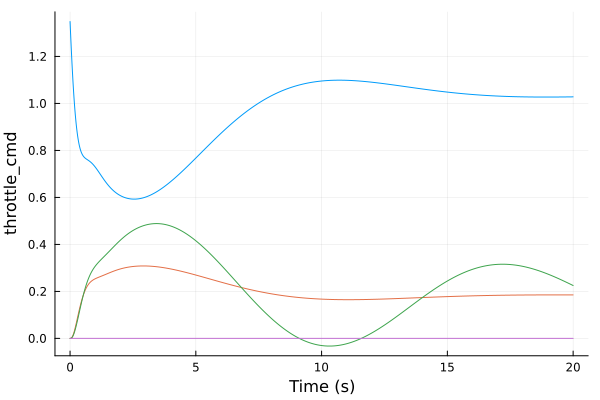

In [10]:
e2e_SAS = P_te[:elevator_cmd, :elevator_cmd_sp]
e2θ_SAS = P_te[:θ, :elevator_cmd_sp]
e2θ_ol = P_lon[:θ, :elevator_cmd]
e2t_SAS = P_te[:throttle_cmd, :elevator_cmd_sp]
step(e2e_SAS, 20) |> plot
step(e2θ_SAS, 20) |> plot!
step(e2θ_ol, 20) |> plot!
step(e2t_SAS, 20) |> plot!

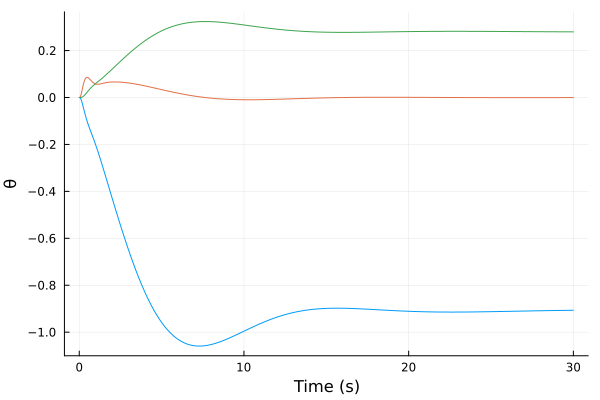

In [11]:
t2e_SAS = P_te[:elevator_cmd, :throttle_cmd_sp]
# t2v_SAS = P_te[:EAS, :throttle_cmd_sp]
t2q_SAS = P_te[:q, :throttle_cmd_sp]
t2θ_SAS = P_te[:θ, :throttle_cmd_sp]
# step(t2t_SAS, 30) |> plot
# step(t2v_SAS, 30) |> plot!
step(t2e_SAS, 30) |> plot
step(t2q_SAS, 30) |> plot!
step(t2θ_SAS, 30) |> plot!

Since we have computed the feedforward gain for the reduced pitch dynamics (instead of the complete, stability-augmented longitudinal dynamics), we get a non-zero steady state error when tracking elevator command setpoint. The benefit, however, is that the throttle setpoint is kept uncoupled from elevator response, so that changing throttle setpoint does not cause elevator movement. This would not be the case had we computed a joint feedforward gain matrix for the complete stability-augmented MIMO system (in that case, the off-diagonal elements in the 2x2 feedforward matrix would couple elevator and throttle commands).

## 2. $q \rightarrow e$

We now design a pitch rate to elevator CAS on top of the stabilized plant using classical SISO techniques.

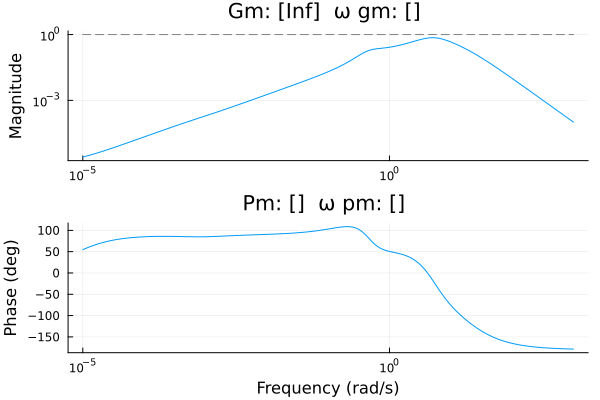

In [12]:
P_e2q = P_te[:q, :elevator_cmd_sp]
marginplot(P_e2q)

┌ Warning: Keyword argument hover not supported with Plots.GRBackend().  Choose from: annotationcolor, annotationfontfamily, annotationfontsize, annotationhalign, annotationrotation, annotations, annotationvalign, arrow, aspect_ratio, axis, background_color, background_color_inside, background_color_outside, background_color_subplot, bar_width, bins, bottom_margin, camera, clims, color_palette, colorbar, colorbar_entry, colorbar_scale, colorbar_title, colorbar_titlefont, colorbar_titlefontcolor, colorbar_titlefontrotation, colorbar_titlefontsize, connections, contour_labels, discrete_values, fill, fill_z, fillalpha, fillcolor, fillrange, fillstyle, flip, fontfamily, fontfamily_subplot, foreground_color, foreground_color_axis, foreground_color_border, foreground_color_grid, foreground_color_subplot, foreground_color_text, formatter, framestyle, grid, gridalpha, gridlinewidth, gridstyle, group, guide, guidefont, guidefontcolor, guidefontfamily, guidefonthalign, guidefontrotation, guidefo

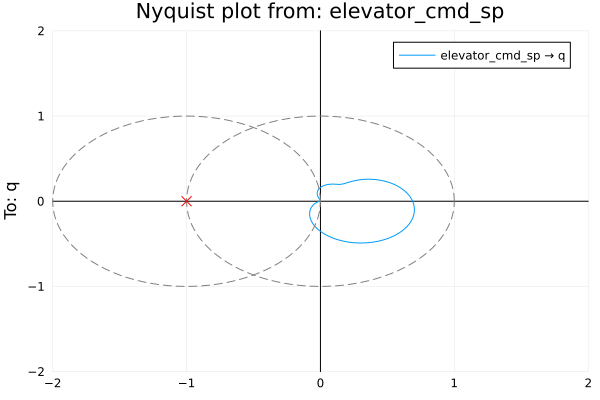

In [13]:
nyquistplot(P_e2q; unit_circle = true, Ms_circles = [1.0])
plot!(ylims = (-2,2), xlims = (-2,2))

The open loop gain goes to zero for $\omega\rightarrow 0$, so we will need two integrators in the loop transfer function in order to achieve a type-1 system and eliminate steady-state error. One of them will be a standalone integrator, the other one will be provided by the PID. 

In [14]:
q2e_int = tf(1, [1, 0]) |> ss
P_q2e_opt = series(q2e_int, ss(P_e2q))

t_sim_q2e = 10
lower_bounds = PIDParams(; k_p = 0.1, k_i = 0.0, k_d = 0.0, τ_f = 0.01)
upper_bounds = PIDParams(; k_p = 10.0, k_i = 50.0, k_d = 2.0, τ_f = 0.01)
settings = Settings(; t_sim = t_sim_q2e, lower_bounds, upper_bounds)
weights = Metrics(; Ms = 1, ∫e = 15, ef = 2, ∫u = 0.1, up = 0.00)
params_0 = PIDParams(; k_p = 2.0, k_i = 15, k_d = 0.4, τ_f = 0.01)

q2e_results = optimize_PID(P_q2e_opt; params_0, settings, weights, global_search)

@unpack k_p, k_i, k_d, T_i, T_d = q2e_results.params
@unpack k_p, k_i, k_d, T_i, T_d = q2e_results.params
@show k_p, k_i, k_d, T_i, T_d
@show q2e_results.metrics
@show q2e_results.exit_flag

(k_p, k_i, k_d, T_i, T_d) = (8.322580415675006, 44.14922401997384, 1.5847903783436823, 0.1885102309365558, 0.1904205545865125)
q2e_results.metrics = [1.2860377418040072, 0.023661337377235997, 0.002577821712084094, 3.208658322631116, 165.80161825004322]
q2e_results.exit_flag = :ROUNDOFF_LIMITED


:ROUNDOFF_LIMITED

In [15]:
q2e_PID = build_PID(q2e_results.params)
# q2e_PID = build_PID(PIDParams(; k_p = 1.594, k_i = 15.216, k_d = 0.102))
C_q2e = named_ss(series(q2e_int, q2e_PID), :C_q2e; u = :q_err, y = :elevator_cmd_sp);

ε_q2e_cl(0) = [0.0;;]


StepInfo:
Initial value:     0.000
Final value:       0.997
Step size:         0.997
Peak:              1.097
Peak time:         0.678 s
Overshoot:         10.00 %
Undershoot:         0.00 %
Settling time:     1.221 s
Rise time:         0.181 s


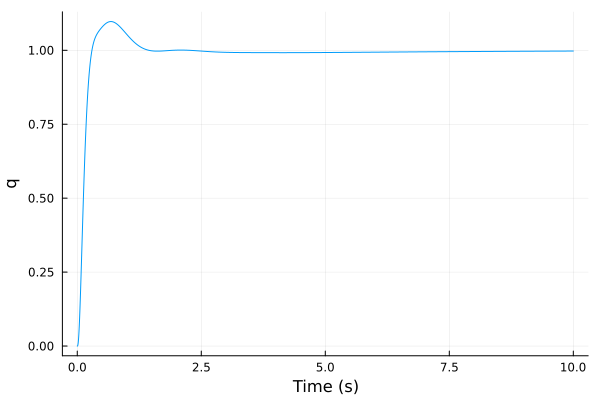

In [16]:
#steady-state error for a unit step input, now zero
L_q2e = series(C_q2e, P_e2q)
ε_q2e_cl = 1/(1+tf(L_q2e))
@show ε_q2e_cl(0)

T_q2e = output_comp_sensitivity(P_e2q, C_q2e) #this is the closed loop transfer function
T_q2e_step = step(T_q2e, t_sim_q2e)
stepinfo(T_q2e_step) |> display
T_q2e_step |> plot

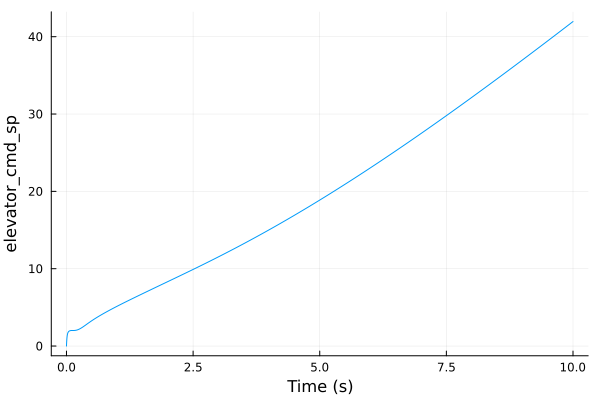

In [17]:
CS_q2e = G_CS(P_e2q, C_q2e)
CS_q2e_step = step(CS_q2e, t_sim_q2e)
CS_q2e_step |> plot

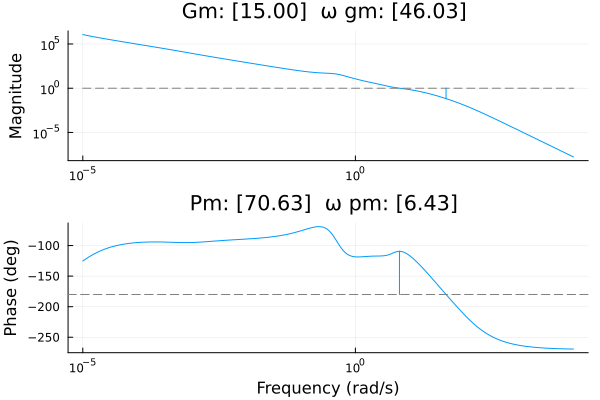

In [18]:
marginplot(L_q2e)

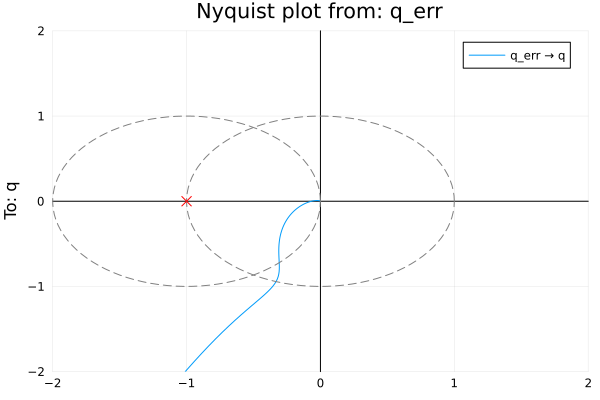

In [19]:
nyquistplot(L_q2e; unit_circle = true, Ms_circles = [1.0])
plot!(ylims = (-2,2), xlims = (-2,2))

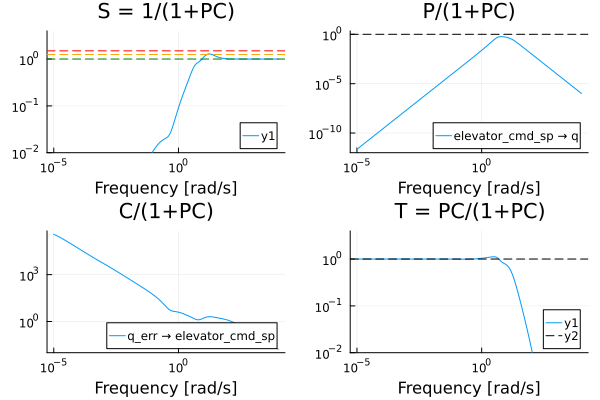

In [20]:
gangoffourplot(P_e2q, C_q2e)

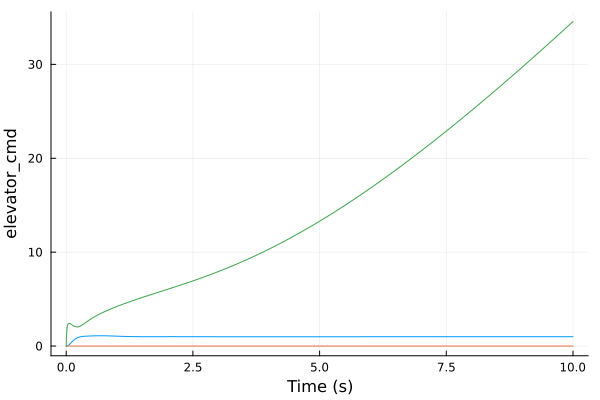

In [21]:
q2e_sum = sumblock("q_err = q_sp - q")
P_tq = connect([P_te, q2e_sum, C_q2e], [:q_err=>:q_err, :q=>:q, :elevator_cmd_sp=>:elevator_cmd_sp], w1 = [:throttle_cmd_sp, :q_sp], z1 = P_te.y)

#verify we get the same response as with the SISO closed loop
qsp2q = P_tq[:q, :q_sp]
qsp2t = P_tq[:throttle_cmd, :q_sp]
qsp2e = P_tq[:elevator_cmd, :q_sp]
step(qsp2q, t_sim_q2e) |> plot
step(qsp2t, t_sim_q2e) |> plot!
step(qsp2e, t_sim_q2e) |> plot!
#and we see that the response matches that of the SISO design

In [22]:
dampreport(P_tq)

|        Pole        |   Damping     |   Frequency   |   Frequency   | Time Constant |
|                    |    Ratio      |   (rad/sec)   |     (Hz)      |     (sec)     |
+--------------------+---------------+---------------+---------------+---------------+
| -7.03e-06          |  1            |  7.03e-06     |  1.12e-06     |  1.42e+05     |
| -0.000954          |  1            |  0.000954     |  0.000152     |  1.05e+03     |
| -0.244             |  1            |  0.244        |  0.0389       |  4.1          |
| -0.901             |  1            |  0.901        |  0.143        |  1.11         |
| -2.17   ±   3.97im |  0.479        |  4.53         |  0.72         |  0.462        |
| -9.2               |  1            |  9.2          |  1.46         |  0.109        |
| -9.91   ±   10.1im |  0.7          |  14.2         |  2.25         |  0.101        |
| -20                |  1            |  20           |  3.18         |  0.05         |
| -49.5              |  1            |  49.

To avoid transients on mode changes, we want the initial output of the pitch rate loop to match the current value of the elevator command setpoint at the pitch SAS input, $e_{cmd,sp}$.

Whenever pitch rate mode is enabled after a mode change, we first reset both the integrator and the PID. Then we set PID integrator's state to the appropriate value to achieve the required $e_{cmd,sp}$. We have:
$$ y_{int} = 0 $$
$$ y_{pid} = k_p y_{int} + k_i x_{i0} = k_i x_{i0} = e_{cmd,sp} $$

Therefore:
$$x_{i0} = e_{cmd, sp}/k_i$$

## 3. $\theta \rightarrow q$


We start with the pitch-rate augmented plant, with throttle and elevator inputs.

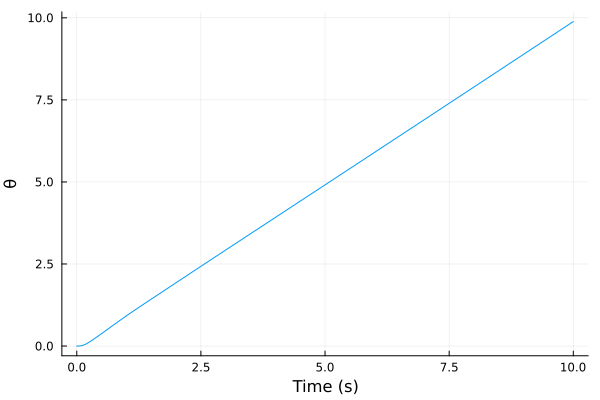

In [23]:
P_q2θ = P_tq[:θ, :q_sp]
step(P_q2θ, 10) |> plot

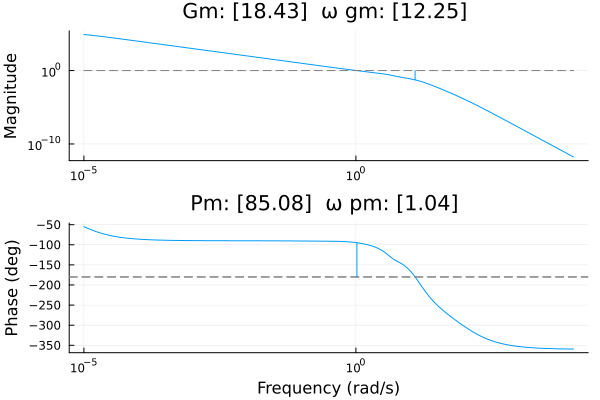

In [24]:
marginplot(P_q2θ)

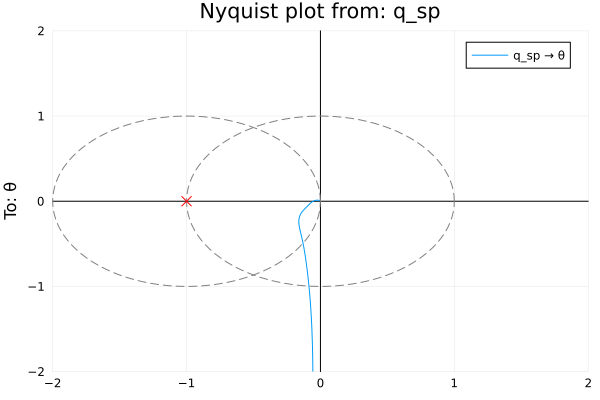

In [25]:
nyquistplot(P_q2θ; unit_circle = true, Ms_circles = [1.0])
plot!(ylims = (-2,2), xlims = (-2,2))

In [26]:
k_p_θ2q = 1
T_i_θ2q = Inf
T_d_θ2q = 0.0
τ_f_θ2q = 0.01
@show k_i_θ2q= k_p_θ2q/ T_i_θ2q
@show k_d_θ2q= k_p_θ2q* T_d_θ2q

θ2q_pid = k_p_θ2q * (1 + 1/T_i_θ2q * tf(1, [1, 0]) + T_d_θ2q * tf([1, 0], [τ_f_θ2q, 1]))
C_θ2q = θ2q_pid
C_θ2q = named_ss(ss(C_θ2q), :C_θ2q; u = :θ_err, y = :q_sp);
L_θ2q = series(C_θ2q, P_q2θ);

k_i_θ2q = k_p_θ2q / T_i_θ2q = 0.0
k_d_θ2q = k_p_θ2q * T_d_θ2q = 0.0


Testing this simple unit gain feedback design, we find out that it works well for the whole EAS range, so for now it does not seem warranted to use a gain scheduled PID compensator.

In [27]:
t_sim_θ2q = 10

10

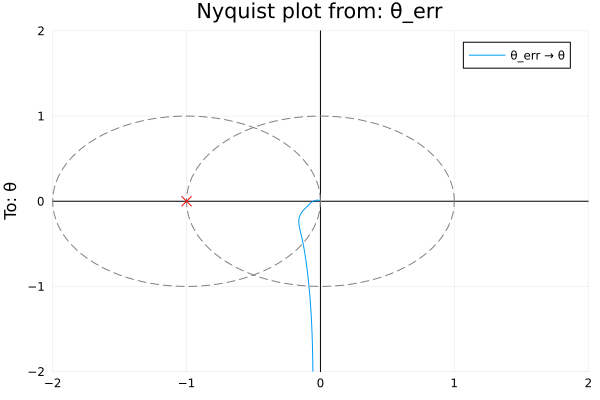

In [28]:
nyquistplot(L_θ2q; unit_circle = true, Ms_circles = [1.0])
plot!(ylims = (-2,2), xlims = (-2,2))

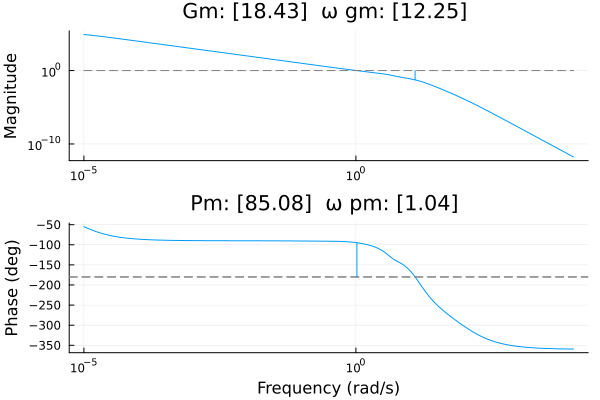

In [29]:
marginplot(L_θ2q)

StepInfo:
Initial value:     0.000
Final value:       1.001
Step size:         1.001
Peak:              1.001
Peak time:         9.578 s
Overshoot:          0.00 %
Undershoot:         0.00 %
Settling time:     3.984 s
Rise time:         1.980 s


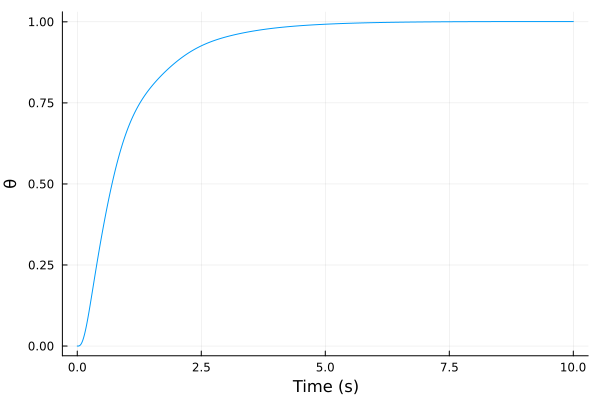

In [30]:
T_θ2q = output_comp_sensitivity(P_q2θ, C_θ2q)
T_θ2q_step = step(T_θ2q, t_sim_θ2q)
stepinfo(T_θ2q_step) |> display
T_θ2q_step |> plot

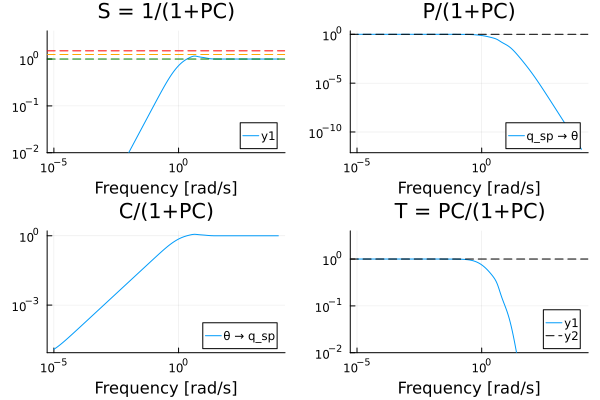

In [31]:
gangoffourplot(P_q2θ, C_θ2q)

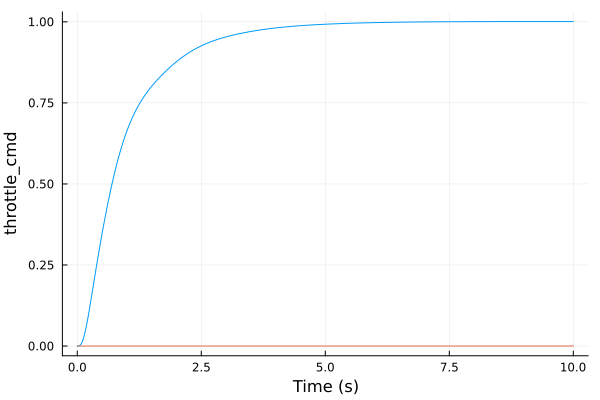

In [32]:
θ2q_sum = sumblock("θ_err = θ_sp - θ")
P_tθ = connect([P_tq, θ2q_sum, C_θ2q], [:θ_err=>:θ_err, :θ=>:θ, :q_sp=>:q_sp], w1 = [:throttle_cmd_sp, :θ_sp], z1 = P_tq.y);

#check we get the same response as with the SISO closed loop
θsp2θ = P_tθ[:θ, :θ_sp]
θsp2t = P_tθ[:throttle_cmd, :θ_sp]
θsp2e = P_tθ[:elevator_cmd, :θ_sp]
step(θsp2θ, t_sim_θ2q) |> plot
step(θsp2t, t_sim_θ2q) |> plot!
# step(θsp2e, t_sim_θ2q) |> plot!

Our linear model comes from a horizontal, wings level flight condition, in which:
$$\dot{\theta} = q$$
However, in the general case we have the following kinematic relations:
$$
q = \dot{\theta} \cos \phi + \dot{\psi} \sin \phi \cos \theta \\
\dot{\psi} = \dfrac{1}{\cos \theta} (q \sin \phi + r \cos \phi)
$$

Substituting the second equation into the first and solving for q we arrive at:
$$
q(\dot{\theta}, r, \phi) = \dfrac{1}{\cos \phi}(\dot{\theta} + r \tan \phi)
$$

This shows that, when we have nonzero $r$ and nonzero $\phi$ (for example, during a turn), maintaining $\dot{\theta} = 0$ requires nonzero $q$. Also, as $\phi$ increases, the gain from $\dot{\theta}$ to $q$ decreases.

Since the $\theta$ controller design assumes $q = \dot{\theta}$, the $q_{sp}$ output by the $\theta$ controller should actually be interpreted as $\dot{\theta}_{sp}$ (or equivalently, the $q_{sp}$ we would need to track the desired $\theta$ in the absence of $r$ and $\phi$). The actual $q_{sp}$ required is given by:
$$q_{sp}=q(\dot{\theta}_{sp}, r, \phi)$$

What would happen during a turn if we didn't introduce this feedforward correction? Since the $\theta$ controller is purely proportional, it can only generate a nonzero output for nonzero $\theta$ error. Therefore, the necessary steady state $q = r \tan \phi$ required by the turn can only be achieved by the $\theta$ controller through a nonzero steady state $\theta$ error. This means that turning would always produce a nonzero steady-state $\theta$ error. The higher the turn rate, the larger the error.

To avoid transients on mode changes, we want the initial $\theta$ loop to produce $\dot{\theta}_{sp} = 0$ when $\theta_{sp}$ is initialized to the current $\theta$. Since this is only a proportional compensator this is unconditionally true:
$$\dot{\theta}_{sp} = k_p (\theta_{sp} - \theta)$$

## 4. EAS $\rightarrow \theta$


We start from the $\theta$-augmented plant. We leave the throttle alone and design a EAS to $\theta$ SISO loop.

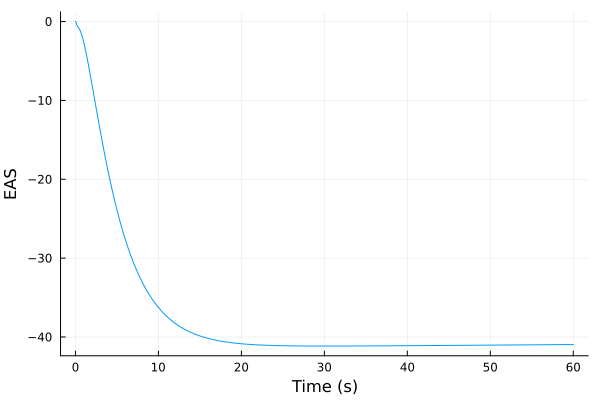

In [33]:
P_θ2v = P_tθ[:EAS, :θ_sp]
step(P_θ2v, 60) |> plot

As expected, we have negative DC gain, so the compensator will require a sign inversion. For design, we can move this inversion to the plant.

In [34]:
zpk(P_θ2v) |> display
P_θ2v_opt = -P_θ2v;

TransferFunction{Continuous, ControlSystemsBase.SisoZpk{Float64, ComplexF64}}
                                                          (1.0s + 49.66038515765838)(1.0s^2 + 5.2541892265919365s + 26.468102937582103)(1.0s^2 - 0.05013947928607905s + 12.01862456834295)(1.0s + 9.185998357888018)(1.0s + 1.1749036123886003)(1.0s + 0.0007664780913459778)
-10179.52141887931---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                  (1.0s + 102.02216693431271)(1.0s + 49.50246325067627)(1.0s^2 + 19.006659526125176s + 182.50585940269136)(1.0s + 9.199417186657318)(1.0s^2 + 3.933867002418644s + 19.730435821129554)(1.0s + 1.4469106553901092)(1.0s + 0.6808672753174486)(1.0s + 0.2545309644912436)(1.0s + 0.0009544797274919748)

Continuous-time transfer functi

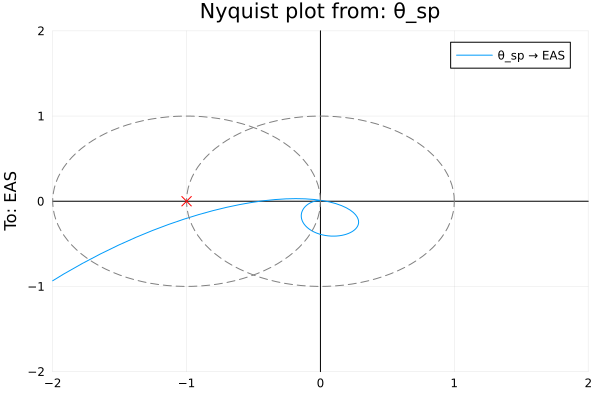

In [35]:
nyquistplot(P_θ2v_opt; unit_circle = true, Ms_circles = [1.0])
plot!(ylims = (-2,2), xlims = (-2,2))

In [36]:
# k_p_v2θ = .04
# T_i_v2θ = 5
# T_d_v2θ = 0.0
# τ_f_v2θ = 0.01
# @show k_i_v2θ= k_p_v2θ/ T_i_v2θ
# @show k_d_v2θ= k_p_v2θ* T_d_v2θ
# v2θ_pid = k_p_v2θ * (1 + 1/T_i_v2θ * tf(1, [1, 0]) + T_d_v2θ * tf([1, 0], [τ_f_v2θ, 1]))
# C_v2θ = -v2θ_pid

t_sim_v2θ = 20
lower_bounds = PIDParams(; k_p = 0.01, k_i = 0.000, k_d = 0.0, τ_f = 0.01)
upper_bounds = PIDParams(; k_p = 0.2, k_i = 0.05, k_d = 0.0, τ_f = 0.01)
settings = Settings(; t_sim = t_sim_v2θ, lower_bounds, upper_bounds)
weights = Metrics(; Ms = 2.0, ∫e = 5.0, ef = 1.0, ∫u = 0.0, up = 0.0)
params_0 = PIDParams(; k_p = 0.05, k_i = 0.01, k_d = 0.0, τ_f = 0.01)

v2θ_results = optimize_PID(P_θ2v_opt; params_0, settings, weights, global_search)
v2θ_pid = build_PID(v2θ_results.params)
C_v2θ = -v2θ_pid
C_v2θ = named_ss(ss(C_v2θ), :C_v2θ; u = :EAS_err, y = :θ_sp)
L_v2θ = series(C_v2θ, P_θ2v);

@unpack k_p, k_i, k_d, τ_f, T_i, T_d = v2θ_results.params
@show k_p, k_i, k_d, τ_f, T_i, T_d
@show v2θ_results.metrics
@show v2θ_results.exit_flag;

(k_p, k_i, k_d, τ_f, T_i, T_d) = (0.04312334923828063, 0.00857410019812292, 0.0, 0.01, 5.029489770567573, 0.0)
v2θ_results.metrics = [1.2871570016292866, 0.14196277748531724, 0.005080880094669893, 0.9727102730840079, 0.9776182424073561]
v2θ_results.exit_flag = :ROUNDOFF_LIMITED


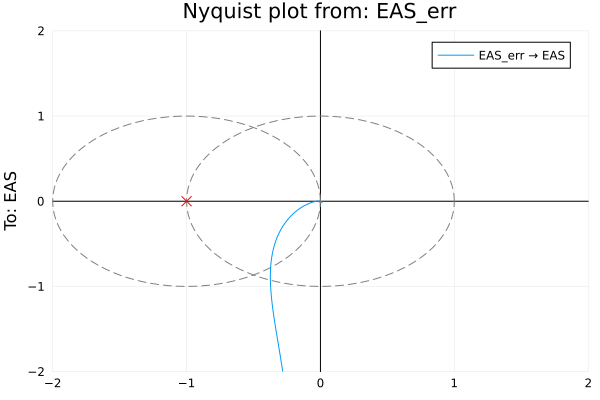

In [37]:
nyquistplot(L_v2θ; unit_circle = true, Ms_circles = [1.0])
plot!(ylims = (-2,2), xlims = (-2,2))


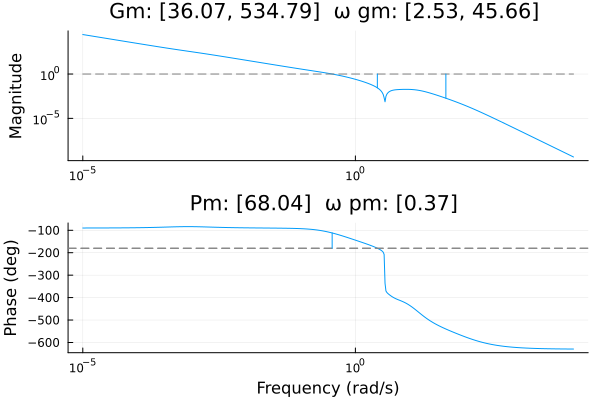

In [38]:
marginplot(L_v2θ)

StepInfo:
Initial value:     0.000
Final value:       0.995
Step size:         0.995
Peak:              1.012
Peak time:         7.387 s
Overshoot:          1.67 %
Undershoot:         0.00 %
Settling time:     5.684 s
Rise time:         3.777 s


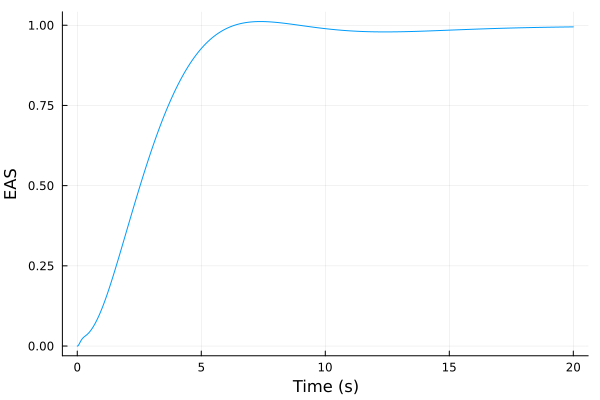

In [39]:
T_v2θ = output_comp_sensitivity(P_θ2v, C_v2θ)
T_v2θ_step = step(T_v2θ, t_sim_v2θ)
stepinfo(T_v2θ_step) |> display
T_v2θ_step |> plot

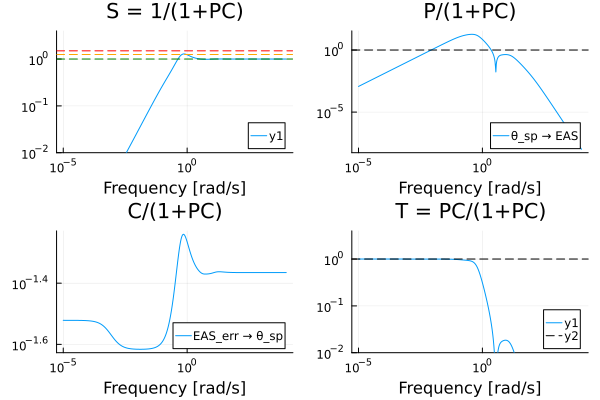

In [40]:
gangoffourplot(P_θ2v, C_v2θ)

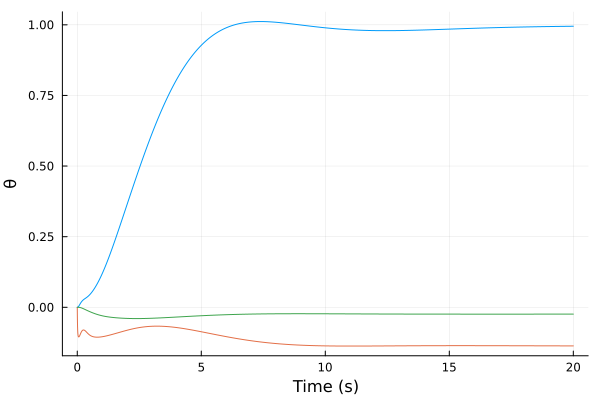

In [41]:
v2θ_sum = sumblock("EAS_err = EAS_sp - EAS")
P_tv = connect([P_tθ, v2θ_sum, C_v2θ], [:EAS_err=>:EAS_err, :EAS=>:EAS, :θ_sp=>:θ_sp], w1 = [:throttle_cmd_sp, :EAS_sp], z1 = P_tθ.y)

#check we get the same response as with the SISO closed loop
EASsp2EAS = P_tv[:EAS, :EAS_sp]
EASsp2e = P_tv[:elevator_cmd, :EAS_sp]
EASsp2θ = P_tv[:θ, :EAS_sp]
step(EASsp2EAS, t_sim_v2θ) |> plot
step(EASsp2e, t_sim_v2θ) |> plot!
step(EASsp2θ, t_sim_v2θ) |> plot!

To avoid transients on mode changes, we want the initial $\theta_{sp}$ output from the $v2\theta$ controller to match the current value of pitch angle $\theta$ when $EAS_{sp}$ matches the current $EAS$.

Whenever $v2\theta$ is enabled after a mode change, we reset the PID. Then we set the PID integrator's state to the appropriate value to achieve the required $\theta$. Noting the sign inversion, we have:
$$ y_{pid} = k_p (EAS_{sp} - EAS) + k_i x_{i0} = k_i x_{i0} $$
$$ \theta_{sp} = -y_{pid}$$

Therefore:
$$x_{i0} = y_{pid} / k_i = -\theta_{sp}/k_i = -\theta/k_i$$

## 5. $EAS \rightarrow t$

To design a SISO EAS-to-throttle controller, we should start from a plant with pitch control augmentation. The throttle-to-EAS response of the raw plant is unsuitable.

|        Pole        |   Damping     |   Frequency   |   Frequency   | Time Constant |
|                    |    Ratio      |   (rad/sec)   |     (Hz)      |     (sec)     |
+--------------------+---------------+---------------+---------------+---------------+
| -0.000954          |  1            |  0.000954     |  0.000152     |  1.05e+03     |
| -0.255             |  1            |  0.255        |  0.0405       |  3.93         |
| -0.681             |  1            |  0.681        |  0.108        |  1.47         |
| -1.45              |  1            |  1.45         |  0.23         |  0.691        |
| -1.97   ±   3.98im |  0.443        |  4.44         |  0.707        |  0.508        |
| -9.2               |  1            |  9.2          |  1.46         |  0.109        |
| -9.5    ±    9.6im |  0.703        |  13.5         |  2.15         |  0.105        |
| -20                |  1            |  20           |  3.18         |  0.05         |
| -49.5              |  1            |  49.

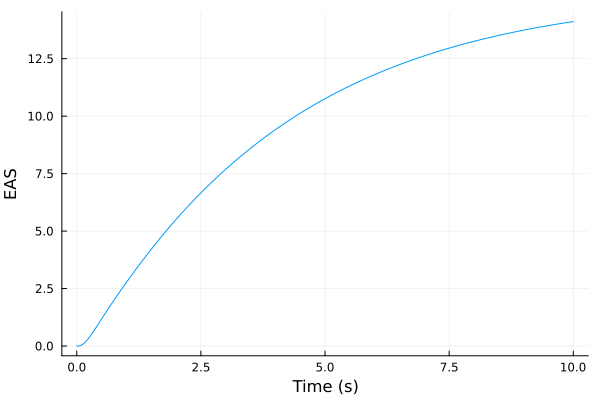

In [42]:
P_t2v = P_tθ[:EAS, :throttle_cmd]

dampreport(P_t2v)
step(P_t2v, 10) |> plot

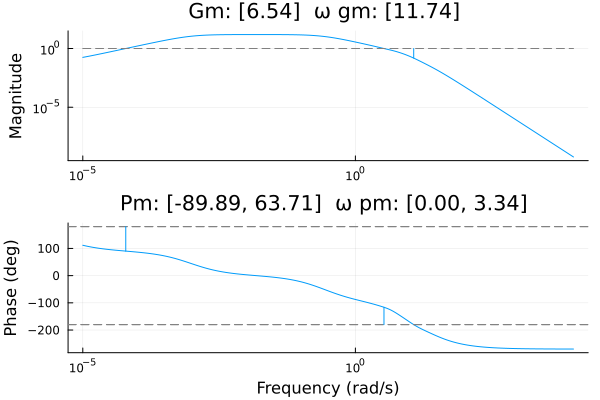

In [43]:
#error transfer function for a unit feedback closed loop and a unit step input
marginplot(P_t2v)

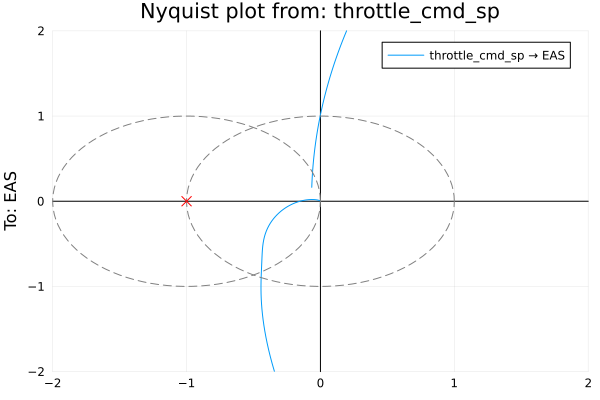

In [44]:
nyquistplot(P_t2v; unit_circle = true, Ms_circles = [1.0])
plot!(ylims = (-2,2), xlims = (-2,2))

In [45]:
t_sim_v2t = 10
lower_bounds = PIDParams(; k_p = 0.1, k_i = 0.0, k_d = 0.0, τ_f = 0.01)
upper_bounds = PIDParams(; k_p = 1.5, k_i = 0.5, k_d = 0.0, τ_f = 0.01)
settings = Settings(; t_sim = t_sim_v2t, maxeval = 5000, lower_bounds, upper_bounds)
weights = Metrics(; Ms = 2.0, ∫e = 5.0, ef = 1.0, ∫u = 0.0, up = 0.0)
params_0 = PIDParams(; k_p = 0.2, k_i = 0.1, k_d = 0.0, τ_f = 0.01)

v2t_results = optimize_PID(P_t2v; params_0, settings, weights, global_search)
v2t_PID = build_PID(v2t_results.params)

C_v2t = named_ss(ss(v2t_PID), :C_v2t; u = :EAS_err, y = :throttle_cmd_sp)
L_v2t = series(C_v2t, P_t2v)

@unpack k_p, k_i, k_d, T_i, T_d = v2t_results.params
@show k_p, k_i, k_d, T_i, T_d
@show v2t_results.metrics
@show v2t_results.exit_flag

(k_p, k_i, k_d, T_i, T_d) = (0.35324417757372606, 0.08833820222349957, 0.0, 3.9987702792502233, 0.0)
v2t_results.metrics = [1.1679771001884283, 0.07554995037192709, 0.0009630030098278786, 0.9127167337732447, 0.9369764103598275]
v2t_results.exit_flag = :ROUNDOFF_LIMITED


:ROUNDOFF_LIMITED

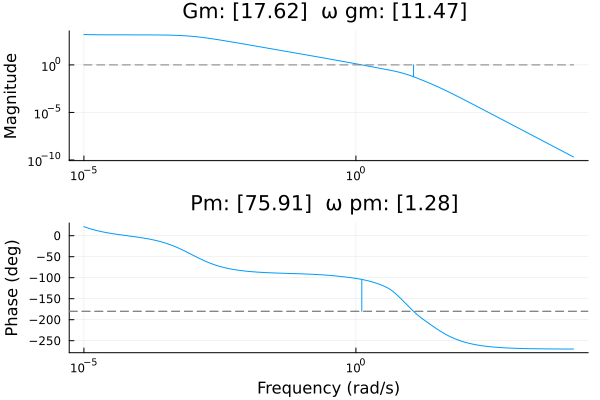

In [46]:
marginplot(L_v2t)

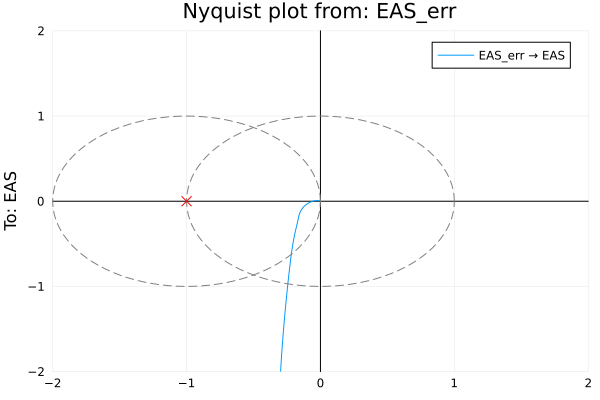

In [47]:
nyquistplot(L_v2t; unit_circle = true, Ms_circles = [1.0])
plot!(ylims = (-2,2), xlims = (-2,2))

StepInfo:
Initial value:     0.000
Final value:       0.999
Step size:         0.999
Peak:              1.006
Peak time:         3.416 s
Overshoot:          0.70 %
Undershoot:         0.00 %
Settling time:     2.065 s
Rise time:         1.250 s


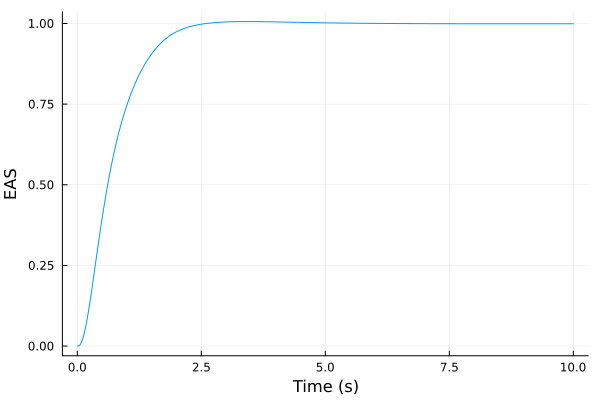

In [48]:
T_v2t = output_comp_sensitivity(P_t2v, C_v2t)
T_v2t_step = step(T_v2t, t_sim_v2t)
stepinfo(T_v2t_step) |> display
T_v2t_step |> plot

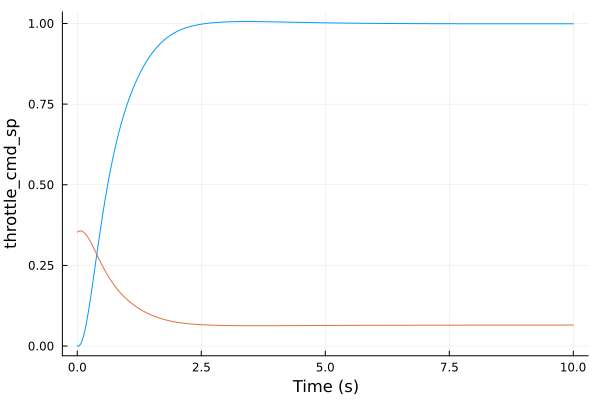

In [49]:
CS_v2t = G_CS(P_t2v, C_v2t)
CS_v2t_step = step(CS_v2t, t_sim_v2t)
CS_v2t_step |> plot!

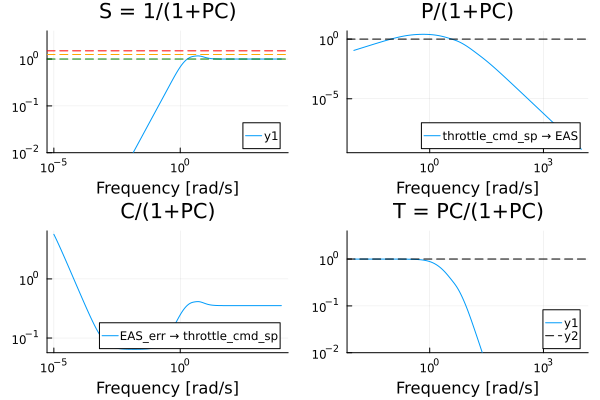

In [50]:
gangoffourplot(P_t2v, C_v2t)

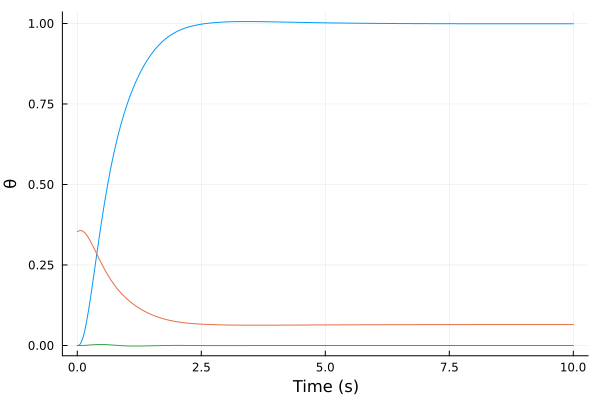

In [51]:
v2t_sum = sumblock("EAS_err = EAS_sp - EAS")
P_vθ = connect([P_tθ, v2t_sum, C_v2t], [:EAS_err=>:EAS_err, :EAS=>:EAS, :throttle_cmd_sp=>:throttle_cmd_sp], w1 = [:EAS_sp, :θ_sp], z1 = P_tθ.y)

#check we get the same response as with the SISO closed loop
EASsp2EAS = P_vθ[:EAS, :EAS_sp]
EASsp2thr = P_vθ[:throttle_cmd, :EAS_sp]
EASsp2θ = P_vθ[:θ, :EAS_sp]
step(EASsp2EAS, t_sim_v2t) |> plot
step(EASsp2thr, t_sim_v2t) |> plot!
step(EASsp2θ, t_sim_v2t) |> plot!

To avoid transients on mode changes, we want the initial throttle command setpoint $thr_{sp}$ output from the $v2t$ controller to match the current value of throttle command $thr$ when $EAS_{sp}$ matches the current $EAS$. Whenever $v2t$ is enabled after a mode change, we reset the PID. Then we set the PID integrator's state to the appropriate value to achieve the required $thr$. We have:
$$thr_{sp} = y_{pid} = k_p (EAS_{sp} - EAS) + k_i x_{i0} = k_i x_{i0} = thr $$

Therefore:
$$x_{i0} = thr/k_i$$

## 6. Climb Rate $\rightarrow \theta$

We assume that this mode will be used together with some form of airspeed control, be it manual or automatic. If airspeed were not maintained, it is likely that in some parts of the envelope, an increase in $\theta$ will actually lead to an altitude loss after an initial surge. Thus, we start from the plant with closed-loop airspeed control via throttle. This scenario corresponds to the altitude hold mode.

|        Pole        |   Damping     |   Frequency   |   Frequency   | Time Constant |
|                    |    Ratio      |   (rad/sec)   |     (Hz)      |     (sec)     |
+--------------------+---------------+---------------+---------------+---------------+
| +4.08e-06          |  -1           |  4.08e-06     |  6.49e-07     |  -2.45e+05    |
| -0.249             |  1            |  0.249        |  0.0397       |  4.01         |
| -0.853             |  1            |  0.853        |  0.136        |  1.17         |
| -1.26              |  1            |  1.26         |  0.201        |  0.793        |
| -1.81              |  1            |  1.81         |  0.288        |  0.552        |
| -2.03   ±   4.03im |  0.449        |  4.52         |  0.719        |  0.494        |
| -5.88              |  1            |  5.88         |  0.935        |  0.17         |
| -9.73   ±   9.62im |  0.711        |  13.7         |  2.18         |  0.103        |
| -21                |  1            |  21 

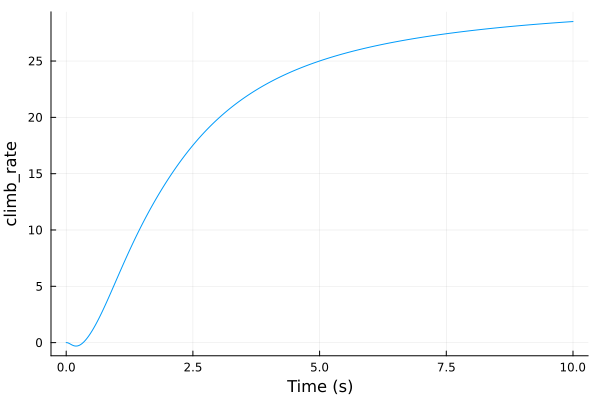

In [52]:
P_θ2c = P_vθ[:climb_rate, :θ_sp]

dampreport(P_θ2c)
step(P_θ2c, 10) |> plot

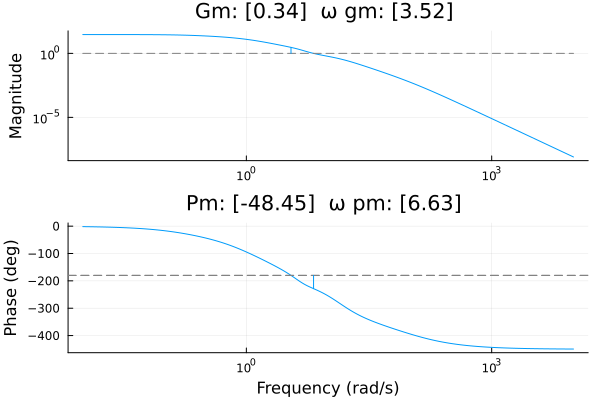

In [53]:
#error transfer function for a unit feedback closed loop and a unit step input
marginplot(P_θ2c)

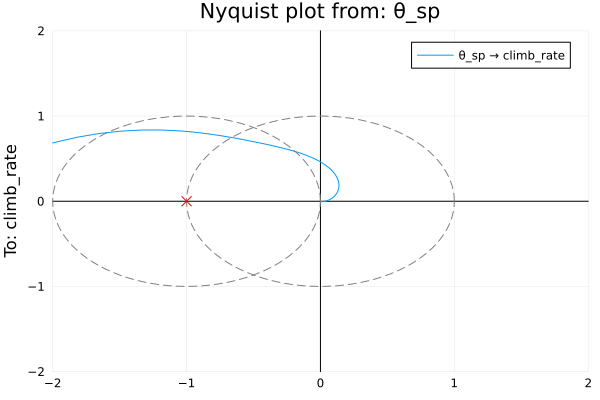

In [54]:
nyquistplot(P_θ2c; unit_circle = true, Ms_circles = [1.0])
plot!(ylims = (-2,2), xlims = (-2,2))

In [55]:
t_sim_c2θ = 10
lower_bounds = PIDParams(; k_p = 0.001, k_i = 0.001, k_d = 0.0, τ_f = 0.01)
upper_bounds = PIDParams(; k_p = 0.05, k_i = 0.03, k_d = 0.0, τ_f = 0.01)
settings = Settings(; t_sim = t_sim_c2θ, maxeval = 5000, lower_bounds, upper_bounds)
weights = Metrics(; Ms = 2.0, ∫e = 3.0, ef = 1.0, ∫u = 0.0, up = 0.1)
params_0 = PIDParams(; k_p = 0.02, k_i = 0.01, k_d = 0.0, τ_f = 0.01)

c2θ_results = optimize_PID(P_θ2c; params_0, settings, weights, global_search)
c2θ_PID = build_PID(c2θ_results.params)

C_c2θ = named_ss(ss(c2θ_PID), :C_c2θ; u = :climb_rate_err, y = :θ_sp)
L_c2θ = series(C_c2θ, P_θ2c)

@unpack k_p, k_i, k_d, T_i, T_d = c2θ_results.params
@show k_p, k_i, k_d, T_i, T_d
@show c2θ_results.metrics
@show c2θ_results.exit_flag

(k_p, k_i, k_d, T_i, T_d) = (0.034926053628449465, 0.01784516911525118, 0.0, 1.9571713444060495, 0.0)
c2θ_results.metrics = [1.2572000416769418, 0.20203211482252398, 0.013785821479830318, 0.9626536413621035, 0.9654654422345722]
c2θ_results.exit_flag = :ROUNDOFF_LIMITED


:ROUNDOFF_LIMITED

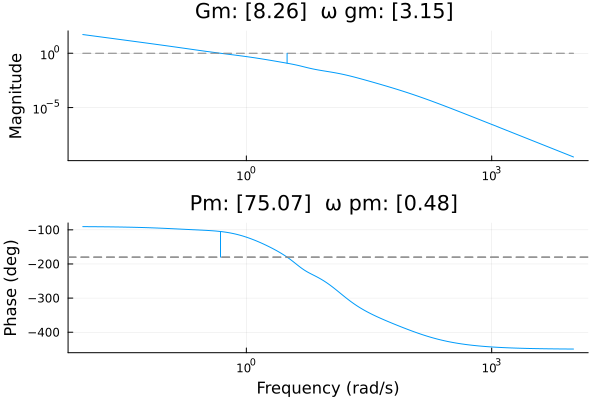

In [56]:
marginplot(L_c2θ)

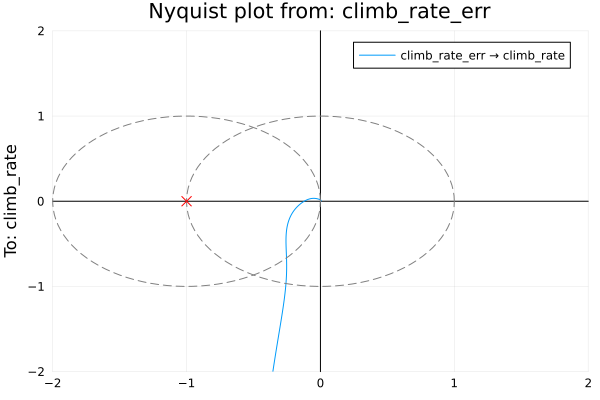

In [57]:
nyquistplot(L_c2θ; unit_circle = true, Ms_circles = [1.0])
plot!(ylims = (-2,2), xlims = (-2,2))

StepInfo:
Initial value:     0.000
Final value:       1.014
Step size:         1.014
Peak:              1.014
Peak time:        10.000 s
Overshoot:          0.00 %
Undershoot:         1.11 %
Settling time:     6.486 s
Rise time:         3.217 s


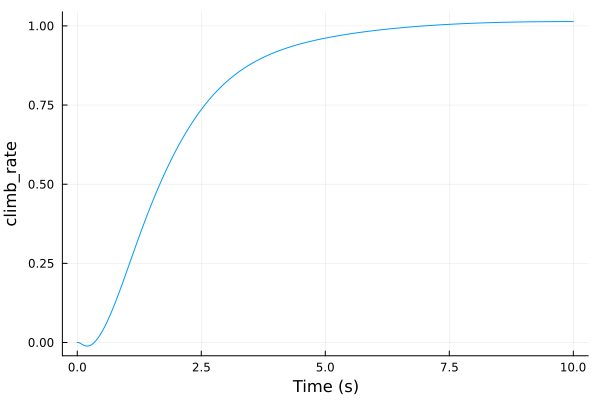

In [58]:
T_c2θ = output_comp_sensitivity(P_θ2c, C_c2θ)
T_c2θ_step = step(T_c2θ, t_sim_c2θ)
stepinfo(T_c2θ_step) |> display
T_c2θ_step |> plot

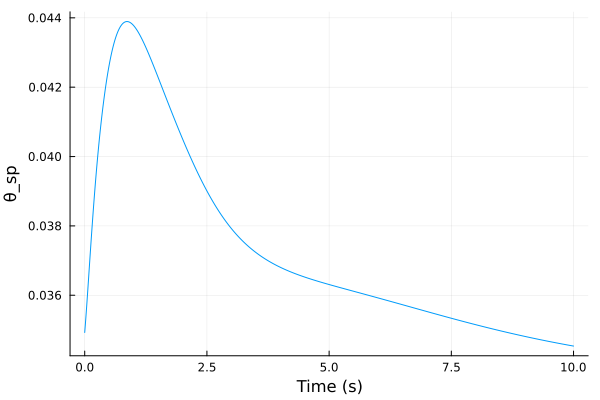

In [59]:
CS_c2θ = G_CS(P_θ2c, C_c2θ)
CS_c2θ_step = step(CS_c2θ, t_sim_c2θ)
CS_c2θ_step |> plot

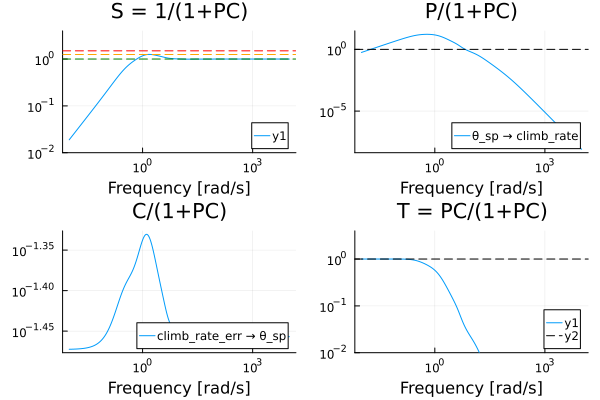

In [60]:
gangoffourplot(P_θ2c, C_c2θ)

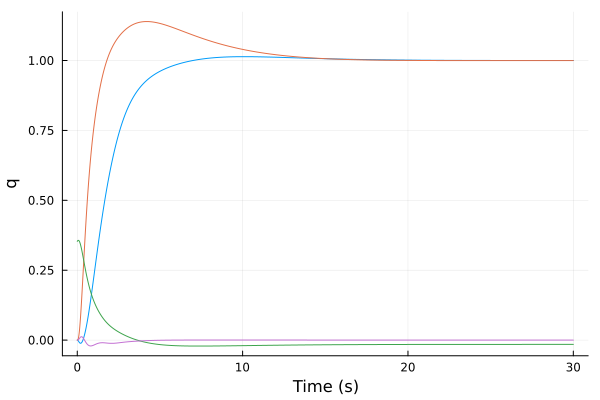

In [61]:
c2θ_sum = sumblock("climb_rate_err = climb_rate_sp - climb_rate")
P_vc = connect([P_vθ, c2θ_sum, C_c2θ], [:climb_rate_err=>:climb_rate_err, :climb_rate=>:climb_rate, :θ_sp=>:θ_sp], w1 = [:EAS_sp, :climb_rate_sp], z1 = P_vθ.y)

#check we get the same response as with the SISO closed loop
crsp2cr = P_vc[:climb_rate, :climb_rate_sp]
EASsp2EAS = P_vc[:EAS, :EAS_sp]
EASsp2thr = P_vc[:throttle_cmd, :EAS_sp]
EASsp2q = P_vc[:q, :EAS_sp]
step(crsp2cr, 30) |> plot
step(EASsp2EAS, 30) |> plot!
step(EASsp2thr, 30) |> plot!
step(EASsp2q, 30) |> plot!

To avoid transients on mode changes, we want the initial $\theta_{sp}$ output from the $c2\theta$ controller to match the current value of pitch angle $\theta$ when $c_{sp}$ matches the current climb rate.

Whenever $c2\theta$ is enabled after a mode change, we reset the PID. Then we set the PID integrator's state to the appropriate value to achieve the required $\theta$. We have:
$$ y_{pid} = k_p (clm_{sp} - clm) + k_i x_{i0} = k_i x_{i0} $$
$$ \theta_{sp} = y_{pid}$$

Therefore:
$$x_{i0} = y_{pid} / k_i = \theta_{sp}/k_i = \theta/k_i$$

## 7. $h \rightarrow c$

We start from the EAS + climb rate plant.

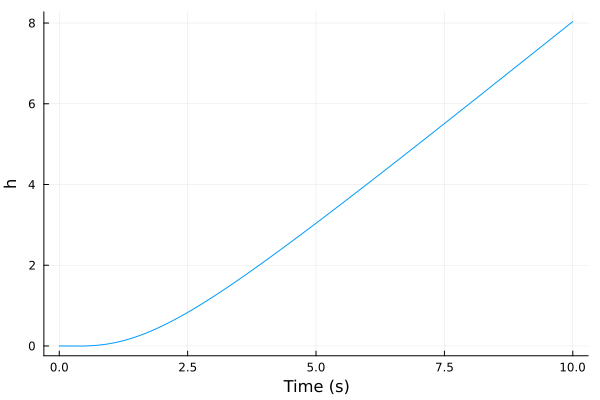

In [62]:
P_c2h = P_vc[:h, :climb_rate_sp]
step(P_c2h, 10) |> plot

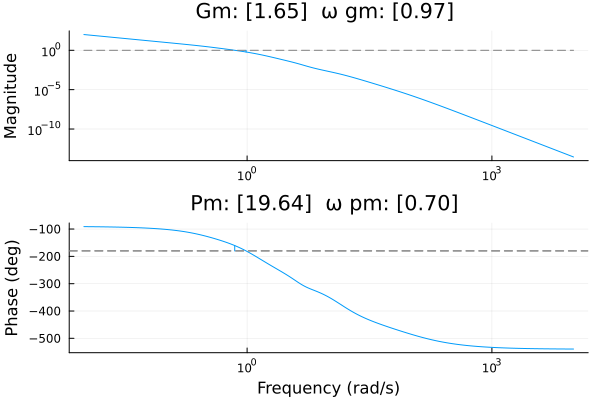

In [63]:
marginplot(P_c2h)

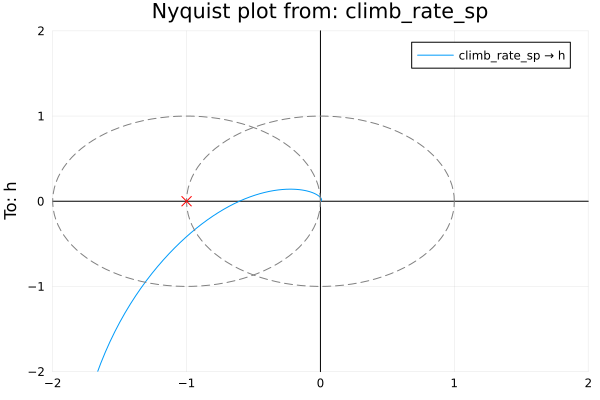

In [64]:
nyquistplot(P_c2h; unit_circle = true, Ms_circles = [1.0])
plot!(ylims = (-2,2), xlims = (-2,2))

In [65]:
k_h2c = 0.2
C_h2c = named_ss(ss(k_h2c), :C_h2c; u = :h_err, y = :climb_rate_sp);
L_h2c = series(C_h2c, P_c2h);

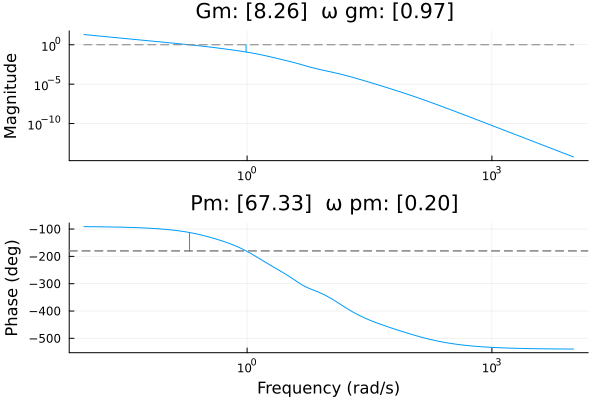

In [66]:
marginplot(L_h2c)

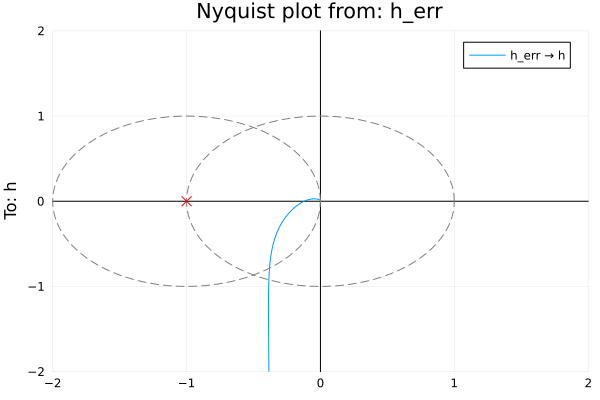

In [67]:
nyquistplot(L_h2c; unit_circle = true, Ms_circles = [1.0])
plot!(ylims = (-2,2), xlims = (-2,2))

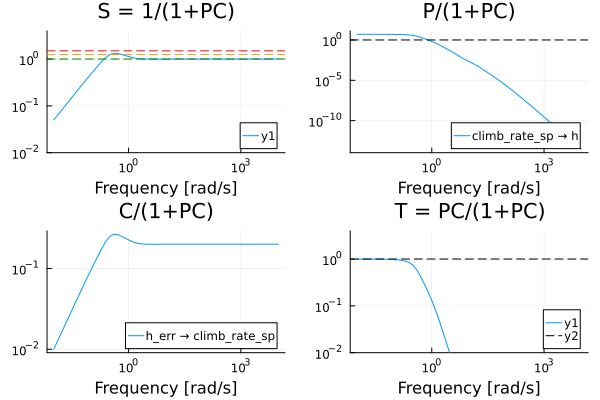

In [68]:
gangoffourplot(P_c2h, C_h2c)